In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


In [29]:
filepath = "../data/balanced_preprocessed_1.csv"
# filepath = "../data/imbalanced_preprocessed_1.csv"


print(f"Data : {filepath}")
df = pd.read_csv(filepath)

# Separate features (X) and target (y)
# X = df.drop(["Category" , "arousal" , "valence"], axis=1)
X = df.drop(["Category"], axis=1)

y = df["Category"]
feature_names = list(X.columns)


Data : ../data/balanced_preprocessed_1.csv


In [30]:
len(X.columns) - 15

53

In [31]:
from sklearn.decomposition import PCA

pca = PCA(n_components=50)  # Reduce to top 5 components
X_selected = pca.fit_transform(X)

In [32]:
X_selected

array([[ 2.75409687e+03, -1.49683926e+03, -2.03650751e+02, ...,
         2.89180144e-02, -2.59452956e-02,  2.59102955e-03],
       [ 2.75972398e+03, -2.31808688e+03,  6.02287978e+02, ...,
        -3.58780240e-02,  3.71355236e-03, -1.23938067e-02],
       [-7.27456748e+03,  1.44614142e+03, -1.49424080e+02, ...,
        -3.03715956e-02,  4.81621335e-03, -8.63116658e-03],
       ...,
       [-6.60881072e+03, -7.39759178e+01, -3.36313861e+02, ...,
        -9.30163446e-03,  1.53238298e-02, -4.22559356e-03],
       [-9.66445580e+03,  1.20635612e+03,  3.70144032e+02, ...,
         1.90474858e-02,  1.53199098e-02, -2.32030123e-02],
       [ 4.48847459e+03, -1.08003649e+03, -1.04246036e+02, ...,
        -5.39292148e-03, -2.85235809e-02, -3.67545424e-03]])

In [33]:
x_df = pd.DataFrame(X_selected)


In [34]:
df_pca = pd.concat([x_df , y] , axis= 1)

In [22]:
import seaborn as sns

sns.pairplot(df_pca)

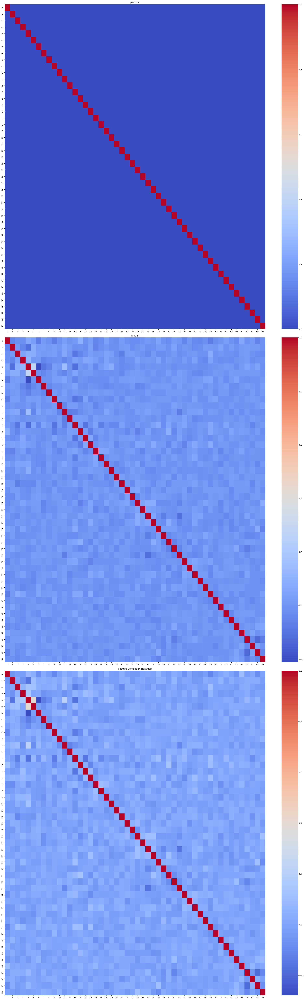

In [35]:

methods = ['pearson', 'kendall', 'spearman']
# Compute the correlation matrix
fig , axes = plt.subplots(3, 1 , figsize = (24 , 24 * 3))

for i, m in enumerate(methods) : 
        
    correlation_matrix = x_df.corr(method= m)
    sns.heatmap(correlation_matrix, cmap="coolwarm", annot=False , ax = axes[i])
    axes[i].set_title(m)

plt.title("Feature Correlation Heatmap")
plt.tight_layout()
plt.show()


In [24]:
df_pca

,0,1,2,3,4,5,6,7,8,9,...,41,42,43,44,45,46,47,48,49,Category
0,2329.345130,-1451.678503,-206.446118,848.336611,179.271972,-180.166152,-214.818678,-261.725117,-12.975392,-83.837450,...,-0.056567,0.004870,-0.054102,-0.004962,0.019680,0.009808,0.025320,-0.012799,0.031230,Class 4
1,2328.737973,-2253.356930,640.120479,-176.421650,-63.912661,-320.828668,-60.218448,239.408670,234.822473,-107.491233,...,0.068665,0.019535,0.065160,-0.066736,-0.044410,-0.017758,0.017771,0.018468,0.009857,Class 4
2,-7703.684649,1487.712017,-156.791559,530.497765,-72.544376,129.648450,-115.296883,201.401131,96.569163,65.635061,...,0.027543,0.019828,-0.007774,0.011168,-0.025208,0.014776,0.023759,0.021953,0.011081,Class 1
3,-6120.004859,1892.698639,-517.001727,272.116592,226.332352,39.019356,-196.254660,186.832590,-62.489665,6.322616,...,0.050671,-0.049858,-0.028705,-0.006353,-0.035535,-0.039071,-0.024767,-0.027412,0.003518,Class 1
4,6188.845037,-1913.213026,391.616460,874.149040,221.739167,-239.736790,-75.555761,-224.256307,4.973093,-48.388534,...,0.015992,-0.029610,-0.039183,0.010510,0.041614,-0.051397,-0.010225,-0.013722,0.008992,Class 4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
475,2174.440544,-2482.501369,-1282.614310,-487.472437,-75.111712,-255.516661,-251.298823,59.815297,49.718299,32.622756,...,0.001807,0.003162,0.044345,-0.028639,0.015532,0.036289,0.005753,-0.003760,0.009460,Class 4
476,906.424424,-3157.042575,-1146.964601,1127.484302,696.908774,21.379984,-675.347360,-623.920276,51.149112,-37.626300,...,-0.092851,0.004133,-0.027319,-0.016653,-0.037787,0.022041,-0.006832,0.026565,-0.069271,Class 2
477,6976.244967,773.908013,-322.700113,516.659458,-245.908237,-679.504545,6.303215,32.770016,-34.138324,-88.095122,...,0.017828,0.049146,0.041010,0.006352,-0.011837,-0.026525,0.007702,-0.002358,-0.027252,Class 3
478,-3413.407896,-2.893256,-485.234737,434.214247,-64.703782,-185.602758,-195.872882,-113.828153,-149.353473,-84.665829,...,-0.013665,-0.009884,0.025768,-0.026472,-0.010838,0.035248,0.014264,0.001435,-0.002993,Class 2


In [36]:
df_pca.to_csv("../data/balanced_pca_2.csv" , index = False)